In [105]:
# Import Libraries
import tensorflow as tf
from tensorflow.keras.layers import Layer, Input, Conv2D, Conv2DTranspose, BatchNormalization, ReLU, Concatenate
from tensorflow.keras.models import Model
import os
import matplotlib.pyplot as plt

In [106]:
# Path to dataset
PATH = '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2'
BATCH_SIZE = 100
IMG_HEIGHT = 256
IMG_WIDTH = 256

In [107]:
# Define Resize Layer
class ResizeLayer(Layer):
    def __init__(self, height, width, **kwargs):
        super(ResizeLayer, self).__init__(**kwargs)
        self.height = height
        self.width = width

    def call(self, inputs):
        x, target_shape = inputs
        return tf.image.resize(x, target_shape, method='bilinear')

In [108]:
# Define the downsample and upsample functions
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False))
    
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False))
    result.add(tf.keras.layers.BatchNormalization())
    
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.3))
    result.add(tf.keras.layers.ReLU())
    return result

In [109]:
def Generator():
    inputs = tf.keras.Input(shape=[IMG_HEIGHT, IMG_WIDTH, 3])
    
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # (bs, 64, 64, 64)
        downsample(128, 4),  # (bs, 32, 32, 128)
        downsample(256, 4),  # (bs, 16, 16, 256)
        downsample(512, 4),  # (bs, 8, 8, 512)
        downsample(512, 4),  # (bs, 4, 4, 512)
        downsample(512, 4),  # (bs, 2, 2, 512)
        downsample(512, 4)   # (bs, 1, 1, 512)
    ]
    
    up_stack = [
        upsample(512, 4, apply_dropout=True),  # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True),  # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True),  # (bs, 8, 8, 1024)
        upsample(256, 4),  # (bs, 16, 16, 512)
        upsample(128, 4),  # (bs, 32, 32, 256)
        upsample(64, 4)    # (bs, 64, 64, 128)
    ]
    
    last = tf.keras.layers.Conv2DTranspose(3, 4, strides=2, padding='same', activation='tanh')  # (bs, 128, 128, 3)
    
    x = inputs
    
    skips = [x]
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    
    for up, skip in zip(up_stack, skips):
        x = up(x)
        if x.shape[1] != skip.shape[1] or x.shape[2] != skip.shape[2]:
            x = tf.image.resize(x, [skip.shape[1], skip.shape[2]])
        x = tf.keras.layers.Concatenate()([x, skip])
    
    x = last(x)
    
    return tf.keras.Model(inputs=inputs, outputs=x)

In [110]:
# Define Discriminator
def Discriminator():
    inputs = Input(shape=[256, 256, 3])
    target = Input(shape=[256, 256, 3])

    x = Concatenate()([inputs, target])
    x = Conv2D(64, 4, strides=2, padding='same')(x)
    x = ReLU()(x)
    x = Conv2D(128, 4, strides=2, padding='same')(x)
    x = ReLU()(x)
    x = Conv2D(256, 4, strides=2, padding='same')(x)
    x = ReLU()(x)
    x = Conv2D(512, 4, strides=2, padding='same')(x)
    x = ReLU()(x)
    x = Conv2D(1, 4, padding='same')(x)
    
    return Model(inputs=[inputs, target], outputs=x)

In [111]:
# Define the loss functions and optimizers
def generator_loss(disc_generated_output, target, gen_output):
    gan_loss = tf.reduce_mean(
        tf.keras.losses.BinaryCrossentropy(from_logits=True)(
            tf.ones_like(disc_generated_output), disc_generated_output
        )
    )
    
    l1_loss = tf.reduce_mean(
        tf.keras.losses.MeanAbsoluteError()(target, gen_output)
    )
    
    total_gen_loss = gan_loss + 100 * l1_loss
    return total_gen_loss, gan_loss, l1_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = tf.reduce_mean(tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_real_output), disc_real_output))
    generated_loss = tf.reduce_mean(tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(disc_generated_output), disc_generated_output))
    return real_loss + generated_loss

In [112]:
@tf.function
def train_step(input_image, target):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)
        
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, target, gen_output)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
    
    gradients_of_generator = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return {
        'gen_total_loss': gen_total_loss,
        'gen_gan_loss': gen_gan_loss,
        'gen_l1_loss': gen_l1_loss,
        'disc_loss': disc_loss
    }

In [113]:
# Dataset creation and loading
def load_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    image = (image / 127.5) - 1
    return image

In [114]:
def create_dataset(folders, batch_size):
    image_pairs = []
    for folder in folders:
        s1_folder = os.path.join(folder, 's1')
        s2_folder = os.path.join(folder, 's2')
        
        s1_images = sorted([os.path.join(s1_folder, img) for img in os.listdir(s1_folder)])
        s2_images = sorted([os.path.join(s2_folder, img) for img in os.listdir(s2_folder)])
        
        # Select only the first 300 images from each folder
        s1_images = s1_images[:1000]
        s2_images = s2_images[:1000]
        
        for s1_image, s2_image in zip(s1_images, s2_images):
            image_pairs.append((s1_image, s2_image))
    
    def load_image_pair(image_pair):
        input_image = load_image(image_pair[0])
        target_image = load_image(image_pair[1])
        return input_image, target_image

    dataset = tf.data.Dataset.from_tensor_slices(image_pairs)
    dataset = dataset.map(load_image_pair, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.shuffle(buffer_size=len(image_pairs))
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    
    return dataset

In [115]:
folders = [os.path.join(PATH, folder) for folder in ['agri', 'barrenland', 'grassland', 'urban']]
train_dataset = create_dataset(folders, BATCH_SIZE)
test_dataset = train_dataset.take(40)  # Taking a subset for testing

print(f'Train dataset size: {len(train_dataset)} batches')
print(f'Test dataset size: {len(test_dataset)} batches')

# Initialize Models and Optimizers
generator = Generator()
discriminator = Discriminator()

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

Train dataset size: 40 batches
Test dataset size: 40 batches


In [116]:
# Define Image Generation Helper Function
def generate_images(model, test_input, target):
    prediction = model(test_input, training=False)
    plt.figure(figsize=(12, 6))

    display_list = [test_input[0], target[0], prediction[0]]
    title = ['Input Image', 'Real Image', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)  # Rescale back to [0, 1]
        plt.axis('off')
    plt.show()

2024-08-24 22:06:20.439960: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape infunctional_133_1/sequential_98_1/dropout_21_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


Epoch 1/50
Generator Losses: Total: 35.2313, GAN: 1.3196, L1: 0.3391
Discriminator Loss: 1.0631


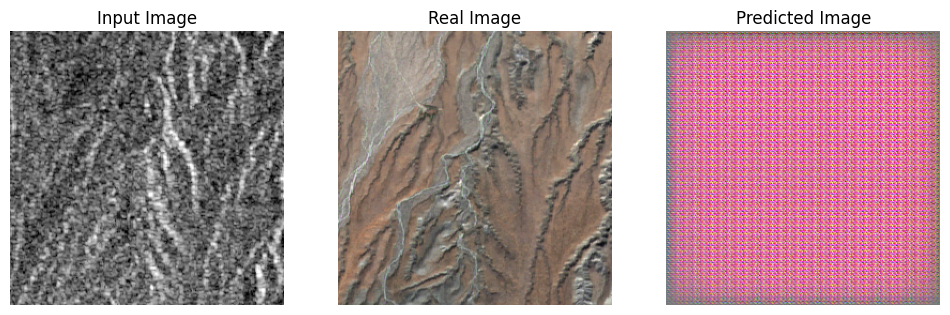

Epoch 2/50
Generator Losses: Total: 30.6537, GAN: 1.3293, L1: 0.2932
Discriminator Loss: 0.8701


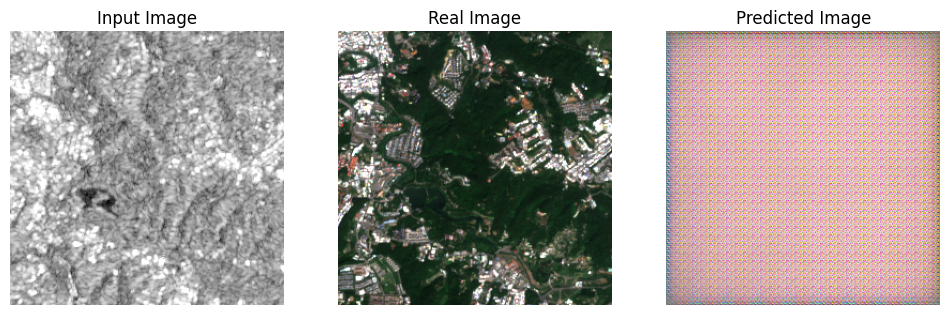

Epoch 3/50
Generator Losses: Total: 30.3158, GAN: 1.6011, L1: 0.2871
Discriminator Loss: 0.8767


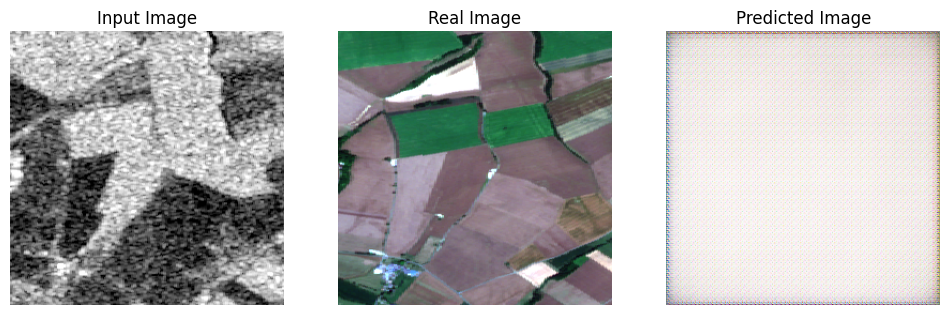

Epoch 4/50
Generator Losses: Total: 29.1337, GAN: 1.3770, L1: 0.2776
Discriminator Loss: 0.7458


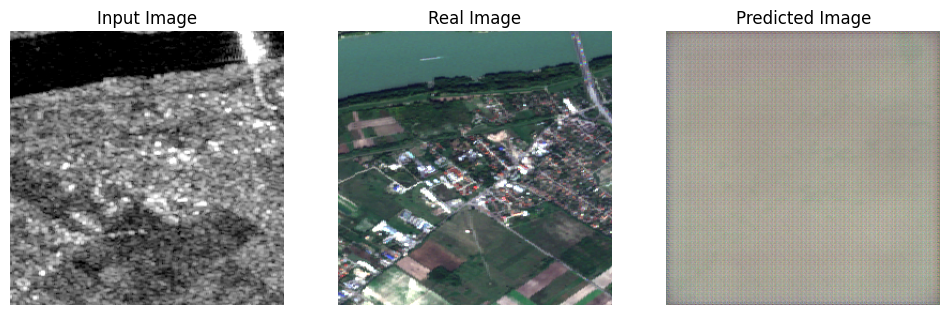

Epoch 5/50
Generator Losses: Total: 29.2433, GAN: 1.8317, L1: 0.2741
Discriminator Loss: 0.6438


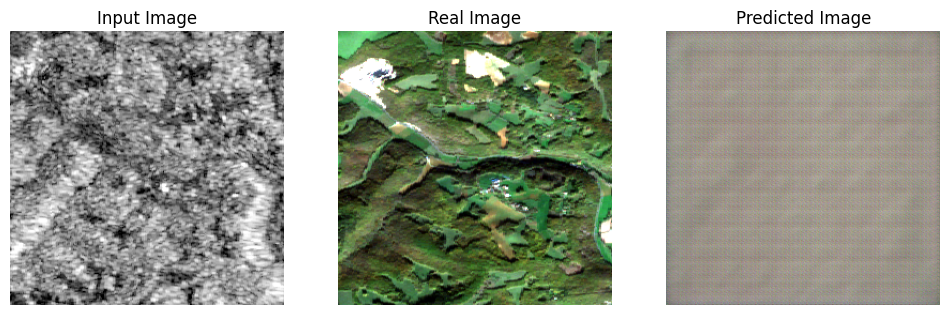

Epoch 6/50
Generator Losses: Total: 28.6580, GAN: 1.8733, L1: 0.2678
Discriminator Loss: 0.6125


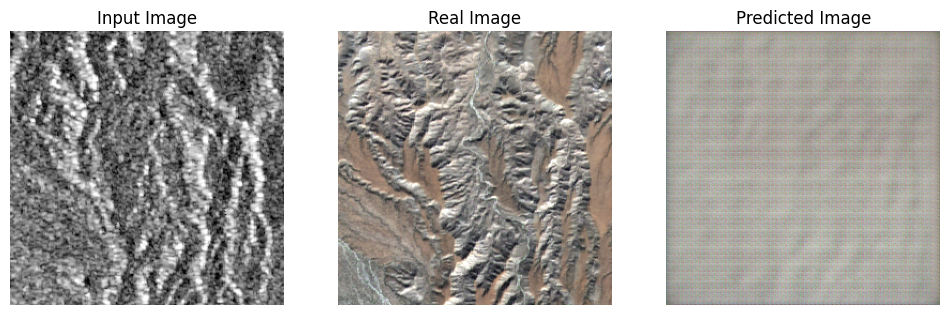

Epoch 7/50
Generator Losses: Total: 27.3603, GAN: 1.7214, L1: 0.2564
Discriminator Loss: 0.6617


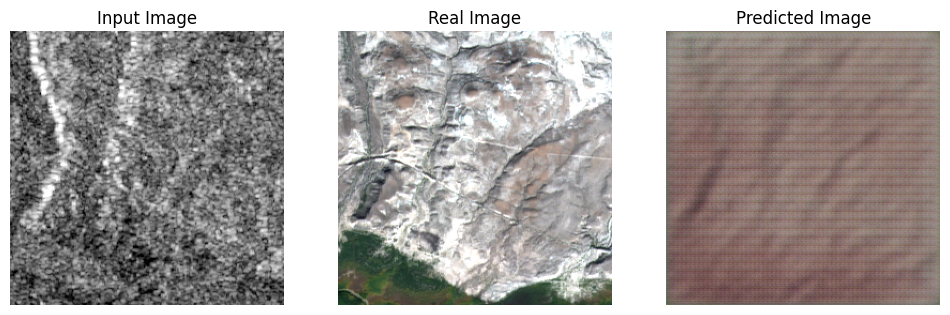

Epoch 8/50
Generator Losses: Total: 26.7719, GAN: 1.7807, L1: 0.2499
Discriminator Loss: 0.6661


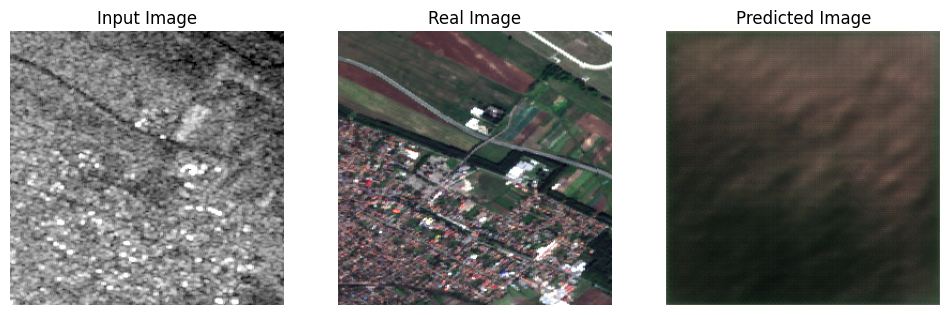

Epoch 9/50
Generator Losses: Total: 26.2106, GAN: 1.7673, L1: 0.2444
Discriminator Loss: 0.6616


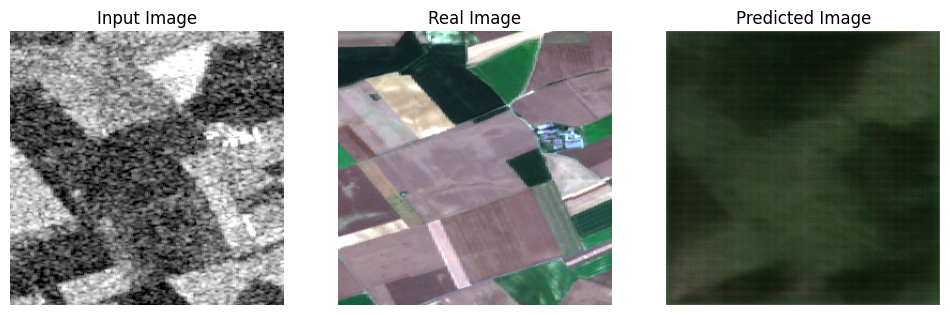

Epoch 10/50
Generator Losses: Total: 25.7044, GAN: 1.8470, L1: 0.2386
Discriminator Loss: 0.6514


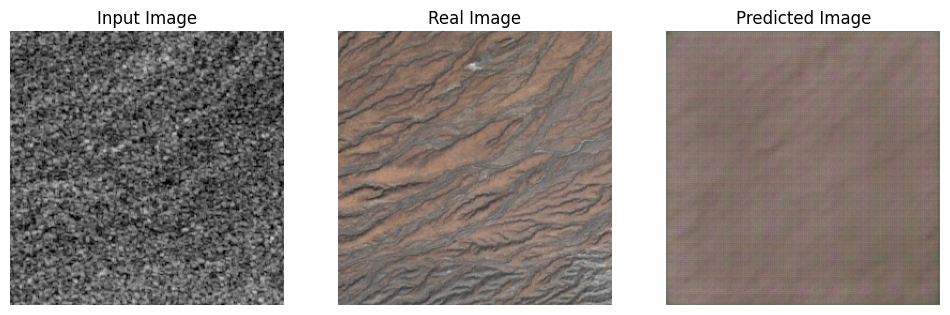

Epoch 11/50
Generator Losses: Total: 25.1823, GAN: 1.8354, L1: 0.2335
Discriminator Loss: 0.6349


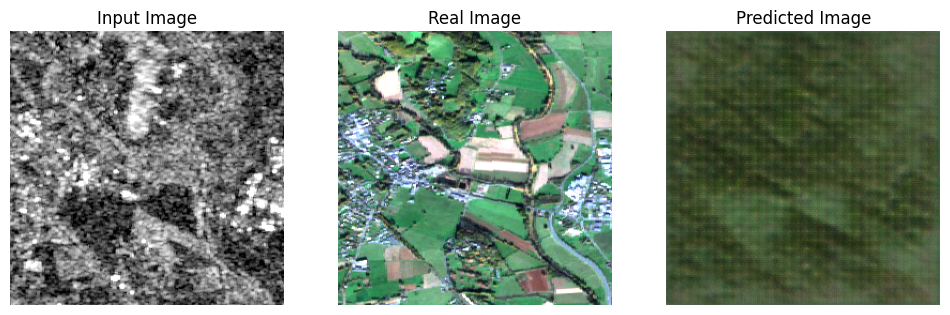

Epoch 12/50
Generator Losses: Total: 24.8763, GAN: 1.8850, L1: 0.2299
Discriminator Loss: 0.6572


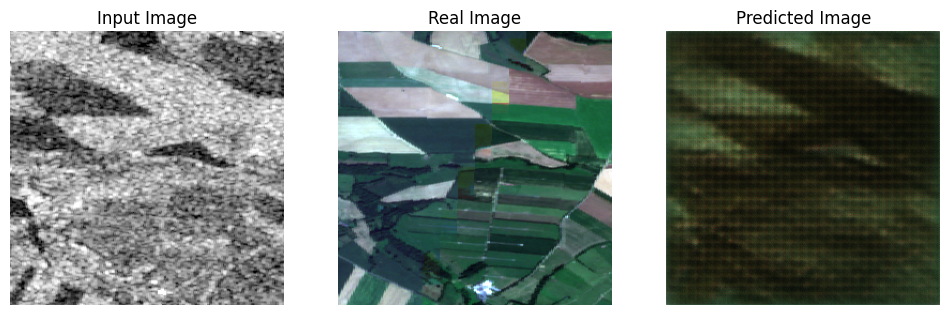

Epoch 13/50
Generator Losses: Total: 24.3088, GAN: 1.8804, L1: 0.2243
Discriminator Loss: 0.6602


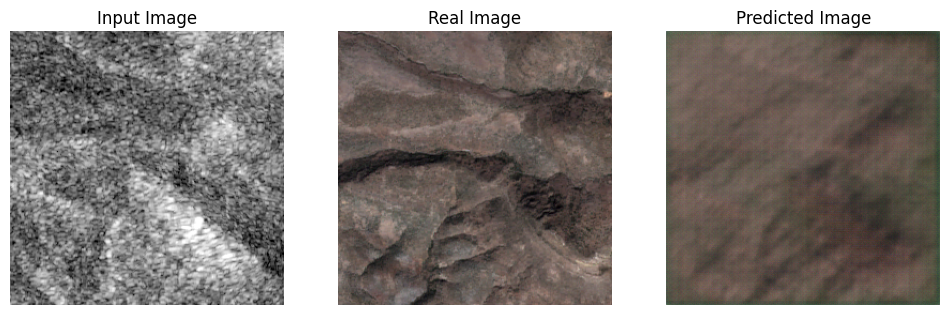

Epoch 14/50
Generator Losses: Total: 23.7685, GAN: 1.8547, L1: 0.2191
Discriminator Loss: 0.6659


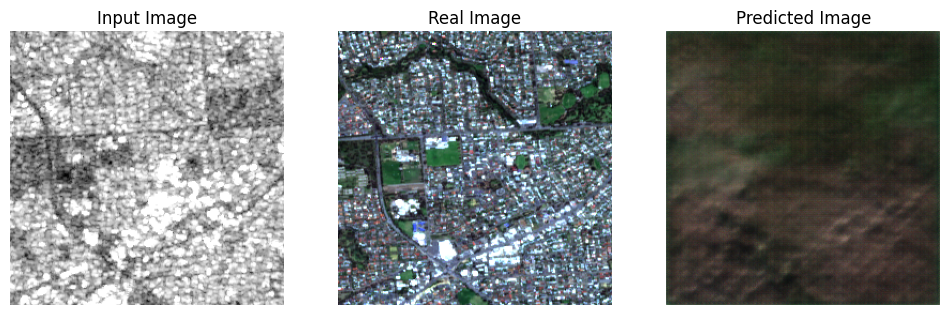

Epoch 15/50
Generator Losses: Total: 23.4141, GAN: 1.8415, L1: 0.2157
Discriminator Loss: 0.6744


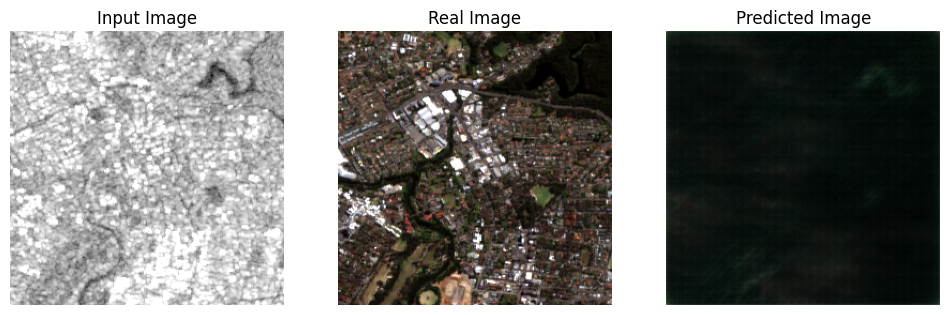

Epoch 16/50
Generator Losses: Total: 22.9913, GAN: 1.7154, L1: 0.2128
Discriminator Loss: 0.7443


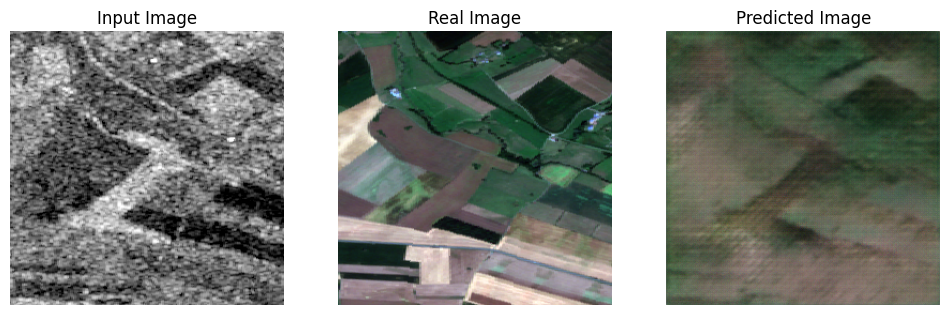

Epoch 17/50
Generator Losses: Total: 22.6473, GAN: 1.7566, L1: 0.2089
Discriminator Loss: 0.7271


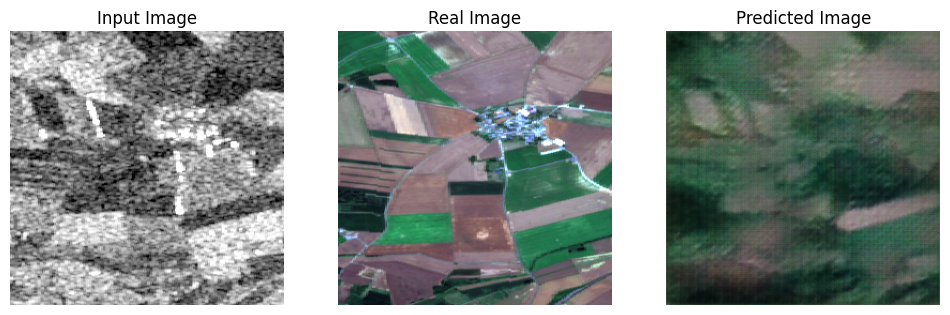

Epoch 18/50
Generator Losses: Total: 22.3899, GAN: 1.6483, L1: 0.2074
Discriminator Loss: 0.7781


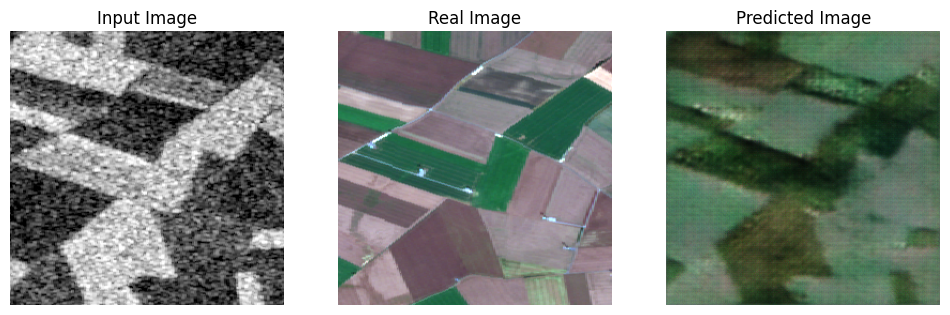

Epoch 19/50
Generator Losses: Total: 22.1468, GAN: 1.6500, L1: 0.2050
Discriminator Loss: 0.8009


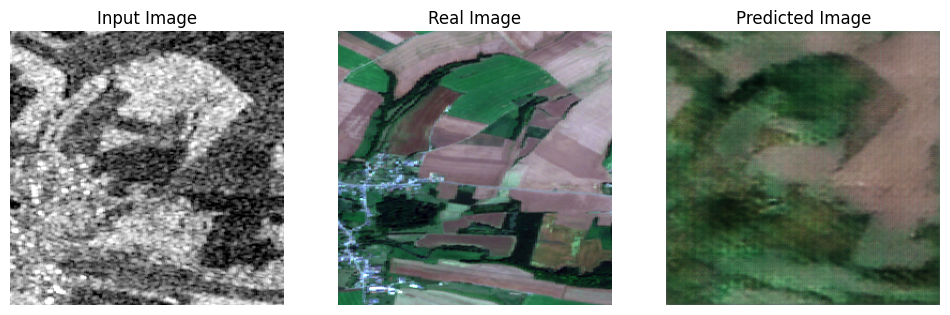

Epoch 20/50
Generator Losses: Total: 21.7363, GAN: 1.5643, L1: 0.2017
Discriminator Loss: 0.8627


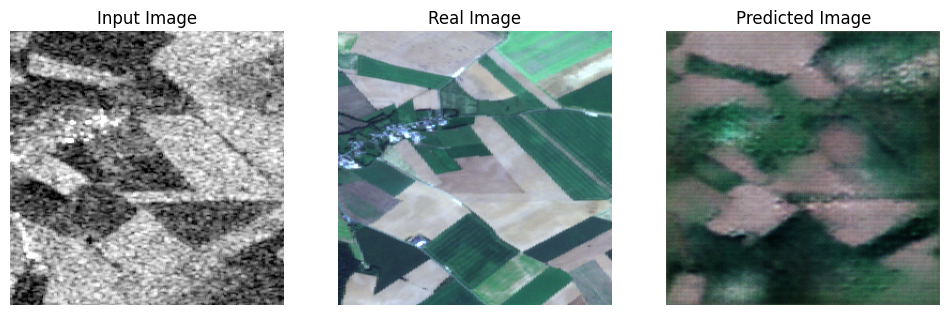

Epoch 21/50
Generator Losses: Total: 21.3686, GAN: 1.5611, L1: 0.1981
Discriminator Loss: 0.8792


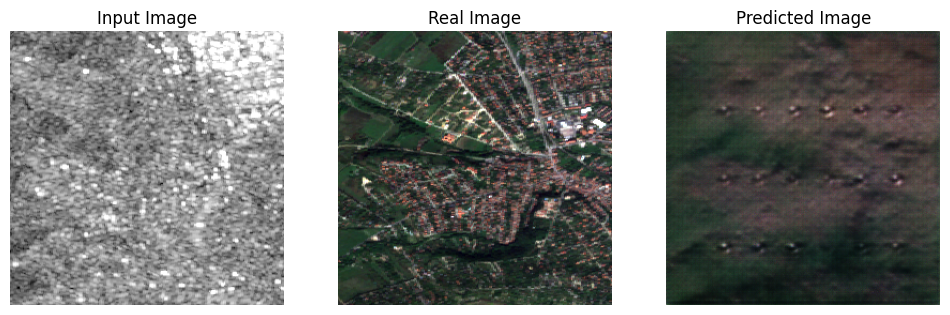

Epoch 22/50
Generator Losses: Total: 21.1473, GAN: 1.4756, L1: 0.1967
Discriminator Loss: 0.9097


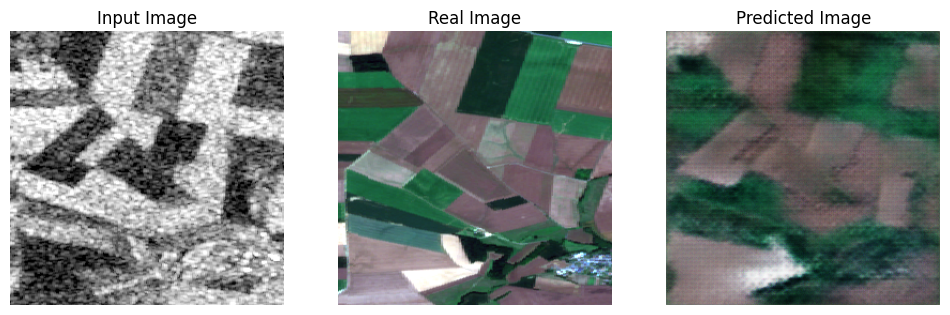

Epoch 23/50
Generator Losses: Total: 20.7428, GAN: 1.5465, L1: 0.1920
Discriminator Loss: 0.8730


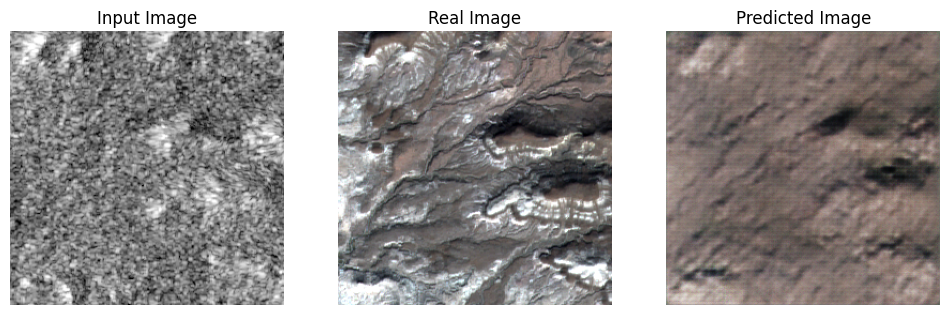

Epoch 24/50
Generator Losses: Total: 20.7436, GAN: 1.4829, L1: 0.1926
Discriminator Loss: 0.8756


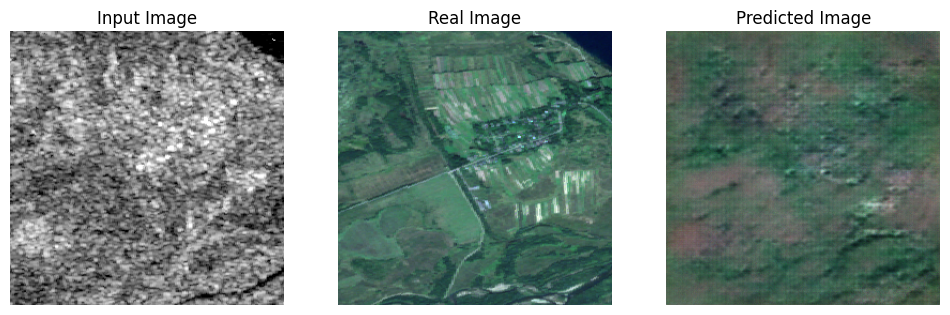

Epoch 25/50
Generator Losses: Total: 20.3892, GAN: 1.5297, L1: 0.1886
Discriminator Loss: 0.8733


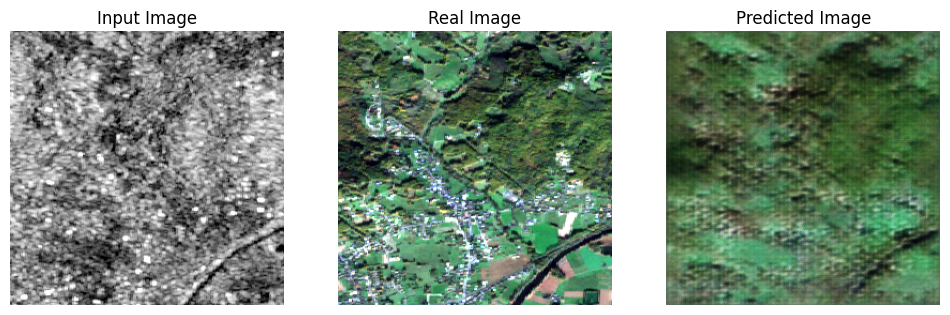

Epoch 26/50
Generator Losses: Total: 20.3226, GAN: 1.4821, L1: 0.1884
Discriminator Loss: 0.8916


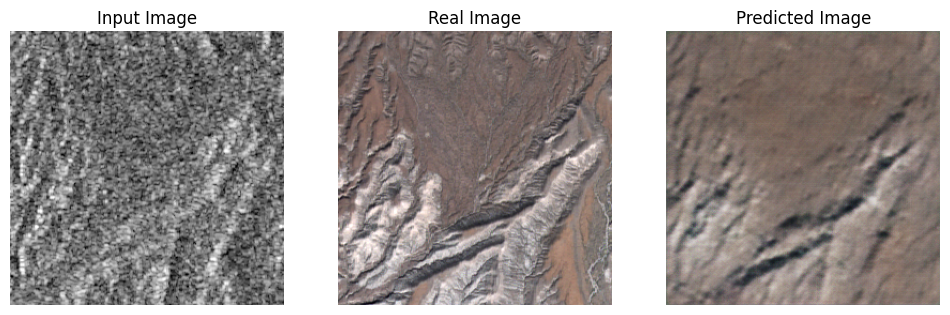

Epoch 27/50
Generator Losses: Total: 20.1074, GAN: 1.4702, L1: 0.1864
Discriminator Loss: 0.8829


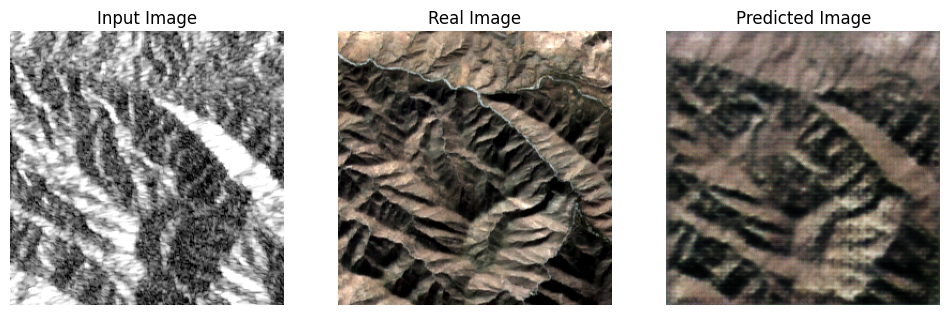

Epoch 28/50
Generator Losses: Total: 19.7967, GAN: 1.4801, L1: 0.1832
Discriminator Loss: 0.8567


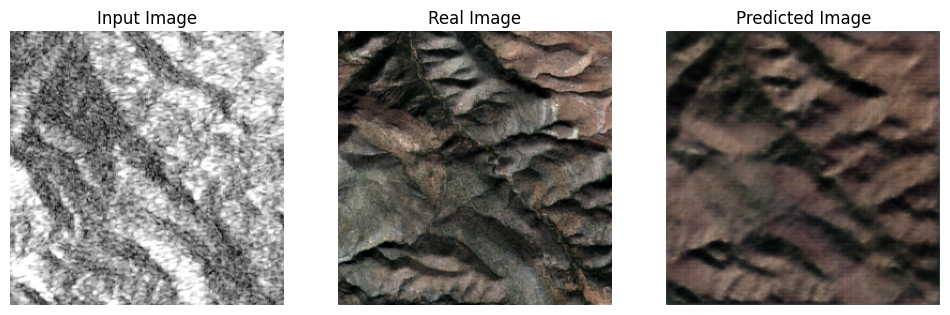

Epoch 29/50
Generator Losses: Total: 19.5825, GAN: 1.4660, L1: 0.1812
Discriminator Loss: 0.8657


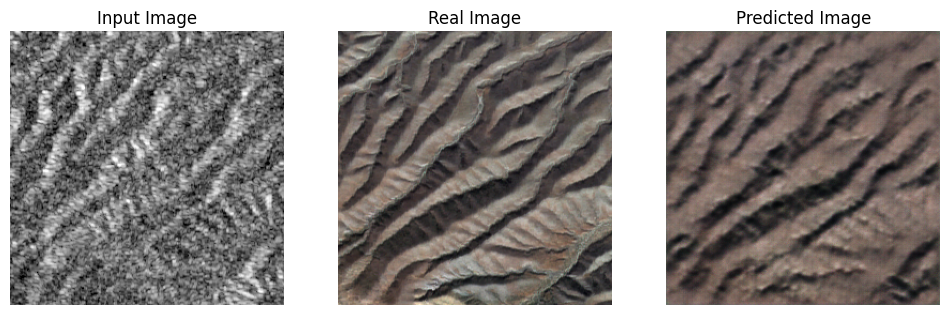

Epoch 30/50
Generator Losses: Total: 19.6328, GAN: 1.4778, L1: 0.1815
Discriminator Loss: 0.8855


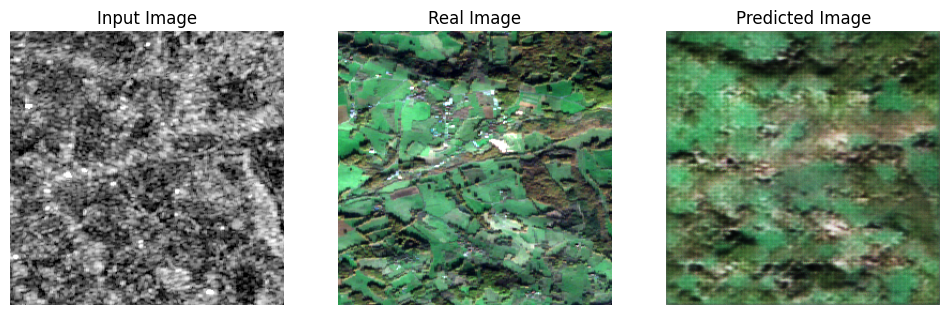

Epoch 31/50
Generator Losses: Total: 19.3301, GAN: 1.4739, L1: 0.1786
Discriminator Loss: 0.8713


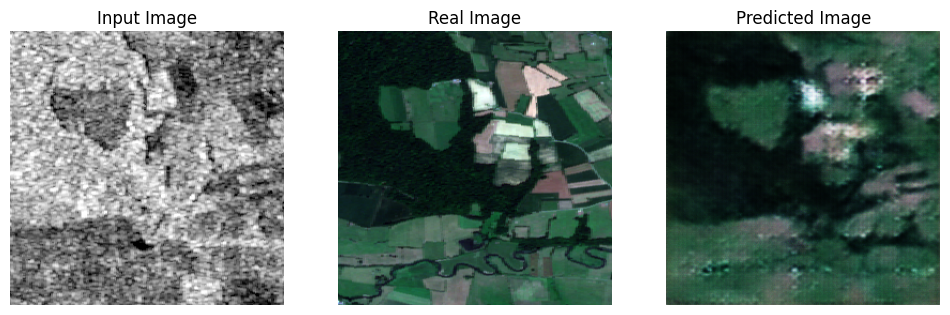

Epoch 32/50
Generator Losses: Total: 19.2316, GAN: 1.4274, L1: 0.1780
Discriminator Loss: 0.8837


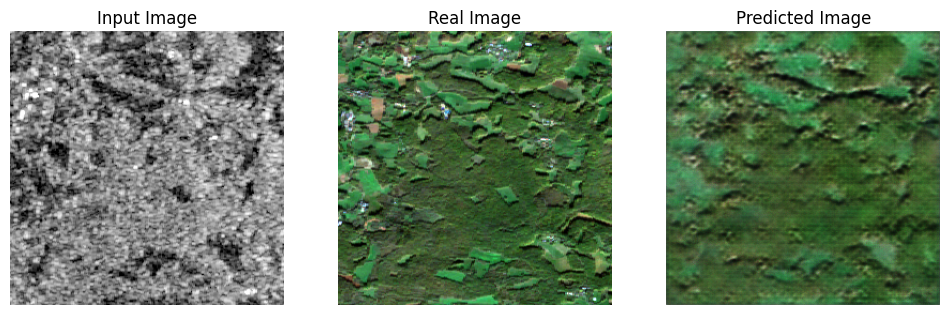

Epoch 33/50
Generator Losses: Total: 19.0832, GAN: 1.4803, L1: 0.1760
Discriminator Loss: 0.9117


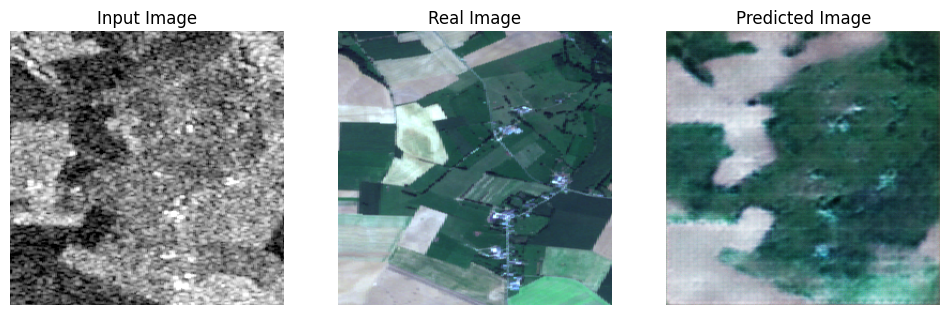

Epoch 34/50
Generator Losses: Total: 18.9046, GAN: 1.4352, L1: 0.1747
Discriminator Loss: 0.8707


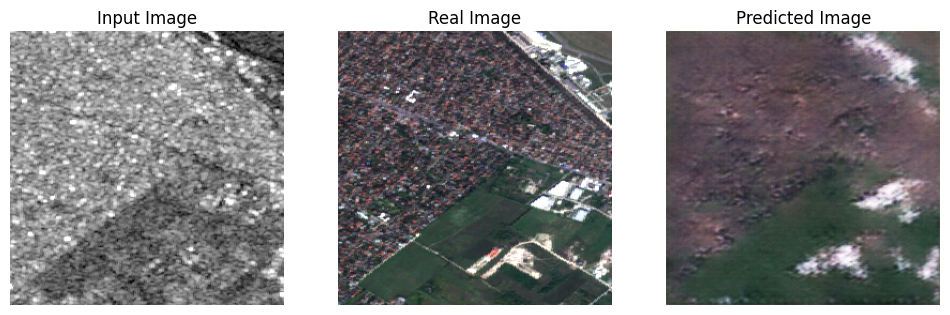

Epoch 35/50
Generator Losses: Total: 19.3428, GAN: 1.4389, L1: 0.1790
Discriminator Loss: 0.9089


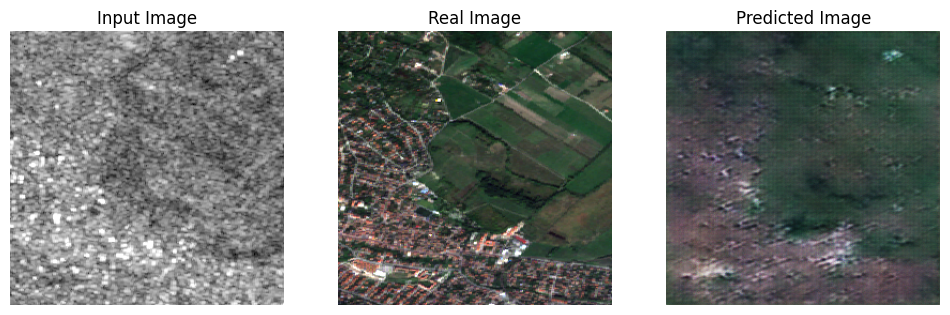

Epoch 36/50
Generator Losses: Total: 18.6659, GAN: 1.4500, L1: 0.1722
Discriminator Loss: 0.8440


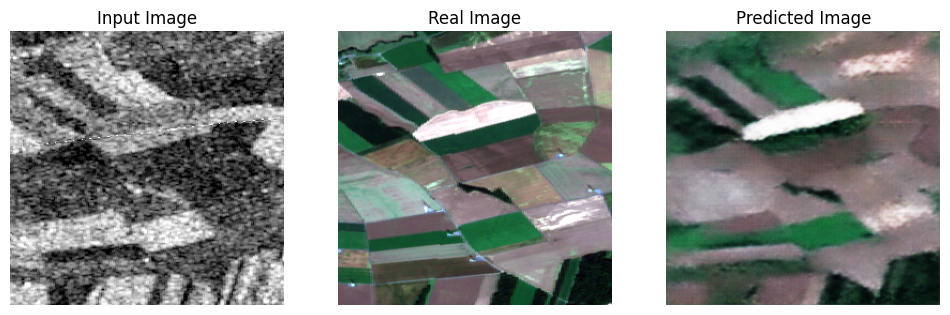

Epoch 37/50
Generator Losses: Total: 18.5959, GAN: 1.4316, L1: 0.1716
Discriminator Loss: 0.8834


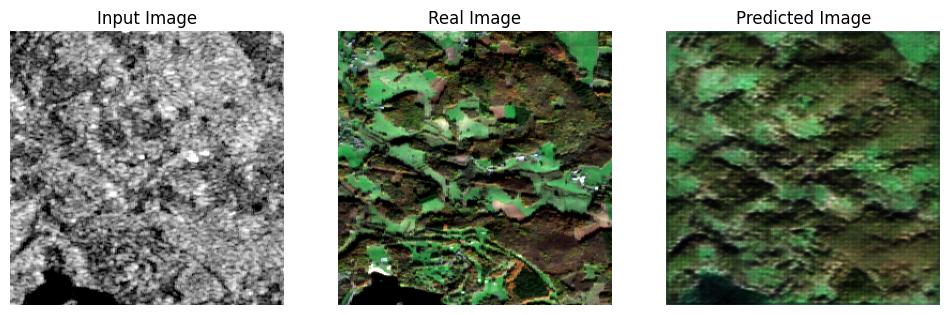

Epoch 38/50
Generator Losses: Total: 18.4394, GAN: 1.4031, L1: 0.1704
Discriminator Loss: 0.9246


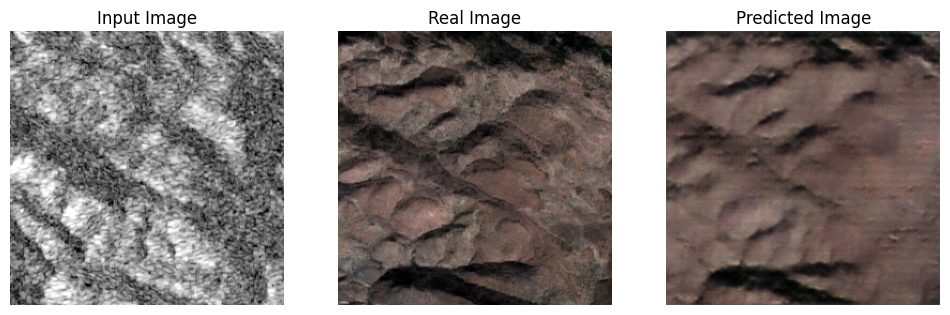

Epoch 39/50
Generator Losses: Total: 18.3046, GAN: 1.4511, L1: 0.1685
Discriminator Loss: 0.8804


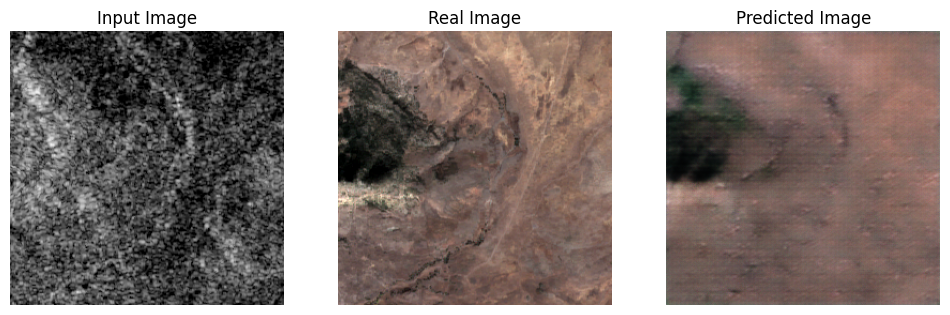

Epoch 40/50
Generator Losses: Total: 18.2183, GAN: 1.4141, L1: 0.1680
Discriminator Loss: 0.8814


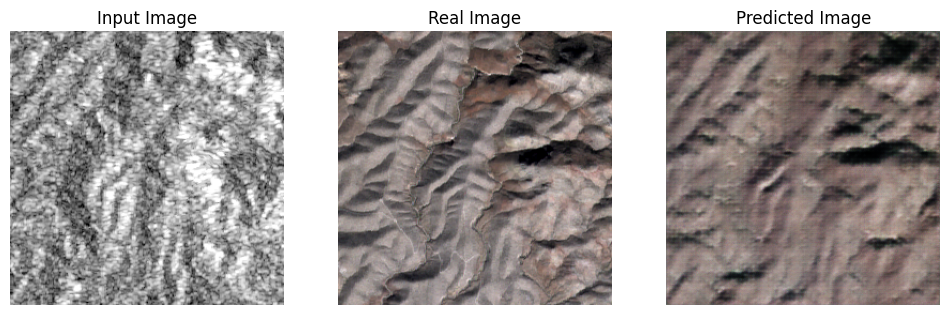

Epoch 41/50
Generator Losses: Total: 17.7607, GAN: 1.4002, L1: 0.1636
Discriminator Loss: 0.9365


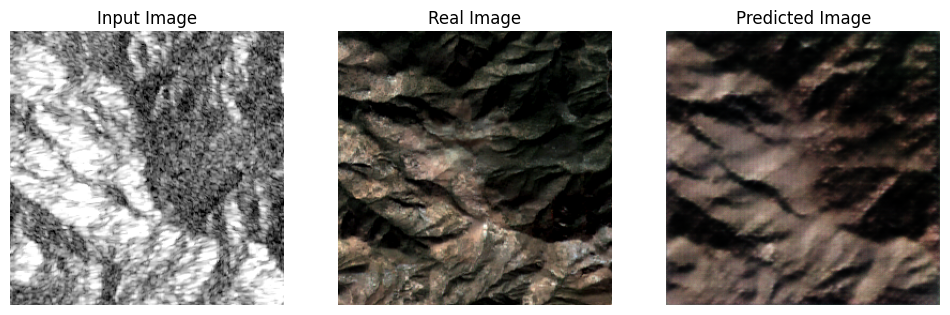

Epoch 42/50
Generator Losses: Total: 17.8538, GAN: 1.4380, L1: 0.1642
Discriminator Loss: 0.8526


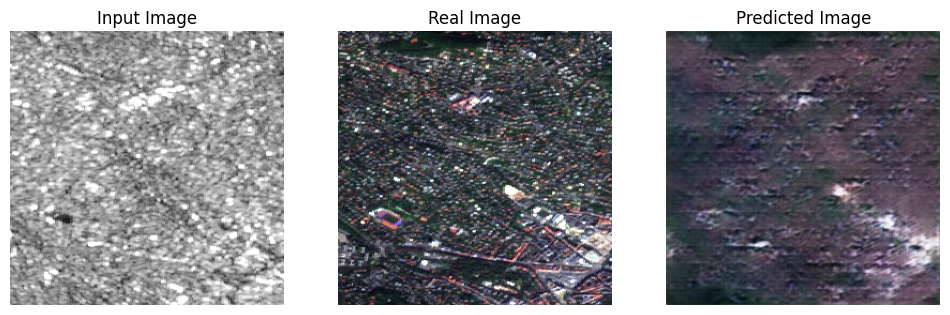

Epoch 43/50
Generator Losses: Total: 17.7519, GAN: 1.4476, L1: 0.1630
Discriminator Loss: 0.8829


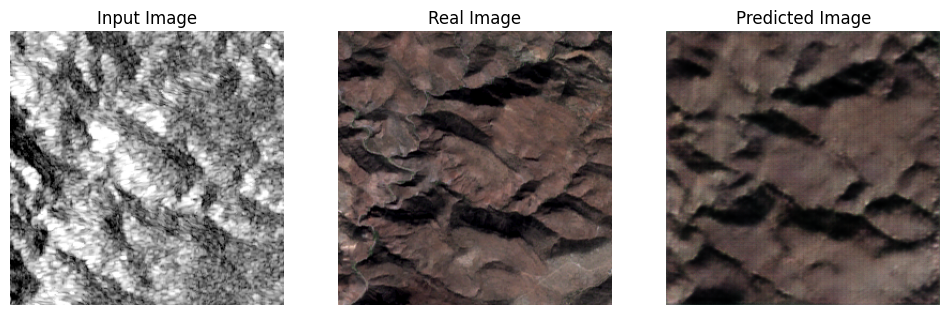

Epoch 44/50
Generator Losses: Total: 17.7315, GAN: 1.4070, L1: 0.1632
Discriminator Loss: 0.8827


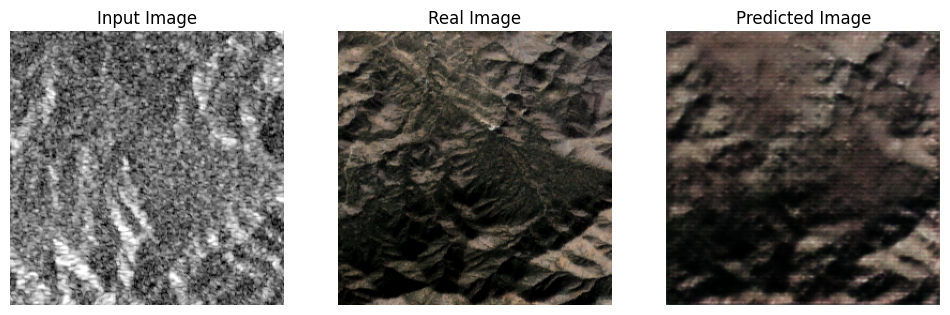

Epoch 45/50
Generator Losses: Total: 17.6191, GAN: 1.4450, L1: 0.1617
Discriminator Loss: 0.9145


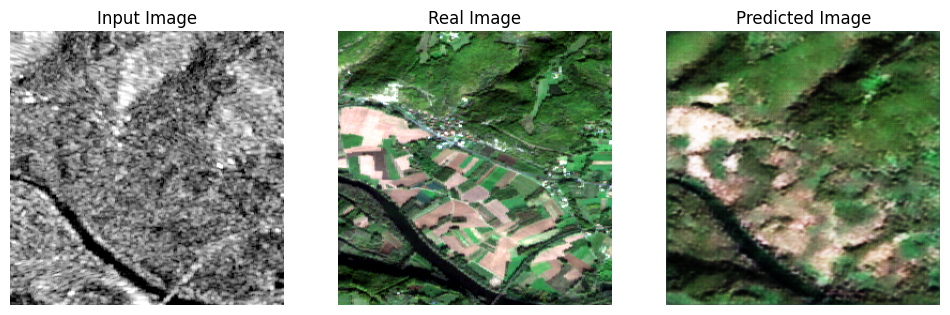

Epoch 46/50
Generator Losses: Total: 17.5849, GAN: 1.4182, L1: 0.1617
Discriminator Loss: 0.8811


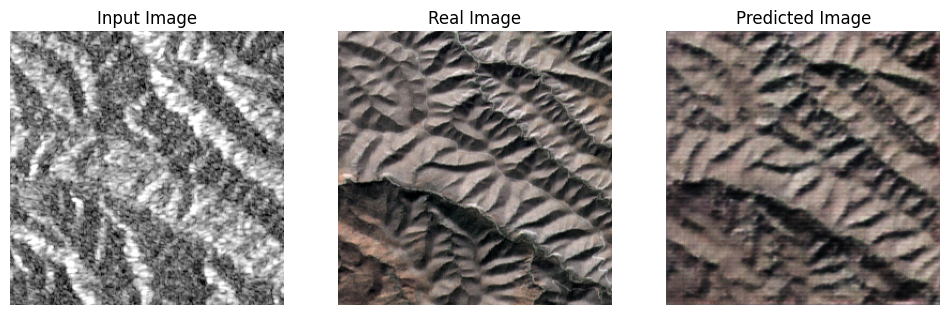

Epoch 47/50
Generator Losses: Total: 17.4046, GAN: 1.4081, L1: 0.1600
Discriminator Loss: 0.8902


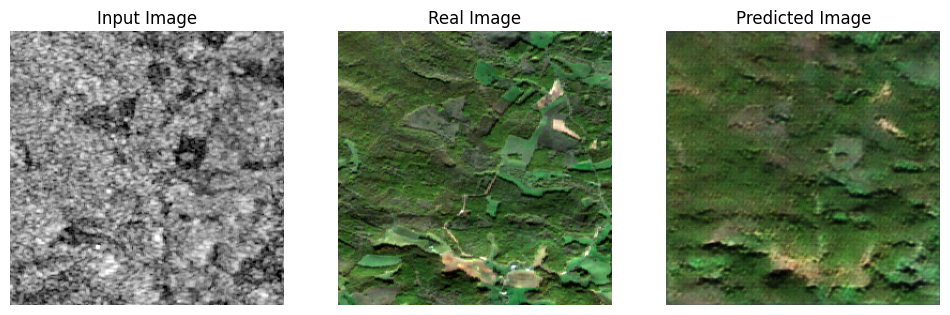

Epoch 48/50
Generator Losses: Total: 17.3740, GAN: 1.3786, L1: 0.1600
Discriminator Loss: 0.9284


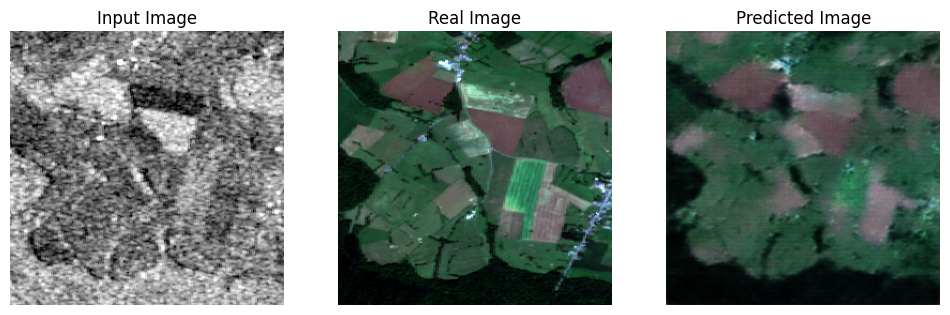

Epoch 49/50
Generator Losses: Total: 17.1272, GAN: 1.4248, L1: 0.1570
Discriminator Loss: 0.8774


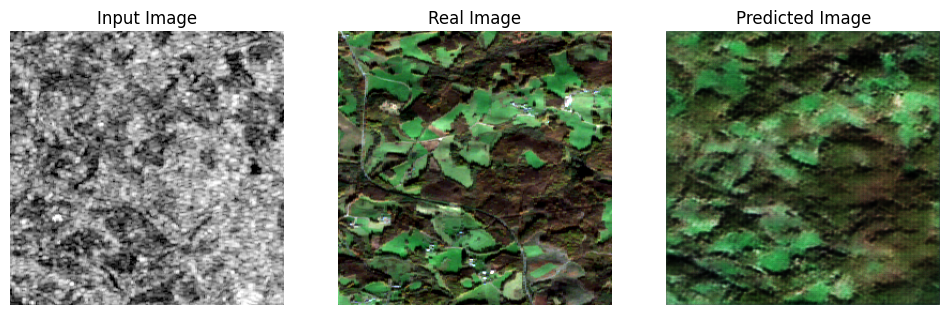

Epoch 50/50
Generator Losses: Total: 17.1958, GAN: 1.3785, L1: 0.1582
Discriminator Loss: 0.9040


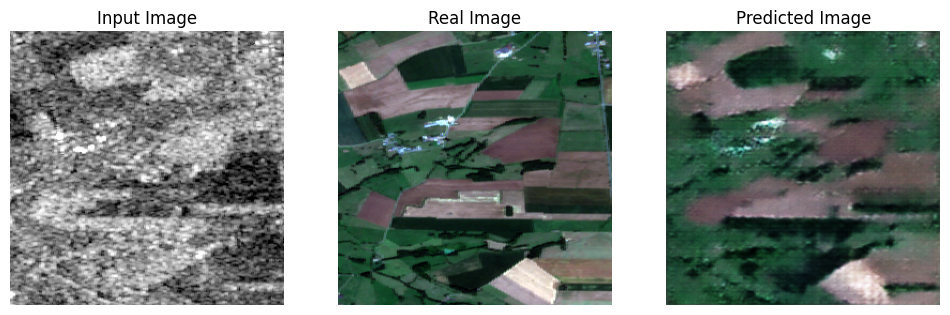

In [117]:
EPOCHS=50

for epoch in range(EPOCHS):
    epoch_gen_total_loss = 0
    epoch_gen_gan_loss = 0
    epoch_gen_l1_loss = 0
    epoch_disc_loss = 0
    num_batches = 0

    for n, (input_image, target) in enumerate(train_dataset):
        losses = train_step(input_image, target)
        epoch_gen_total_loss += losses['gen_total_loss']
        epoch_gen_gan_loss += losses['gen_gan_loss']
        epoch_gen_l1_loss += losses['gen_l1_loss']
        epoch_disc_loss += losses['disc_loss']
        num_batches += 1

    # Average losses over the epoch
    epoch_gen_total_loss /= num_batches
    epoch_gen_gan_loss /= num_batches
    epoch_gen_l1_loss /= num_batches
    epoch_disc_loss /= num_batches

    print(f'Epoch {epoch + 1}/{EPOCHS}')
    print(f'Generator Losses: Total: {epoch_gen_total_loss:.4f}, GAN: {epoch_gen_gan_loss:.4f}, L1: {epoch_gen_l1_loss:.4f}')
    print(f'Discriminator Loss: {epoch_disc_loss:.4f}')
    
    generate_images(generator, *next(iter(test_dataset)))

In [118]:
print("DONE")

DONE


In [119]:
generator.save('/kaggle/working/generator.h5')
discriminator.save('/kaggle/working/discriminator.h5')

print("DONE")

DONE


In [123]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess_image(image_path, target_size=(256, 256)):
    """Load and preprocess an image."""
    img = image.load_img(image_path, target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Create a batch axis
    img_array = img_array / 255.0  # Normalize to [0, 1]
    return img_array

def load_models(generator_path, discriminator_path):
    """Load the generator and discriminator models."""
    generator = tf.keras.models.load_model(generator_path)
    discriminator = tf.keras.models.load_model(discriminator_path)
    return generator, discriminator

def generate_images(model, test_input):
    """Generate and display images."""
    prediction = model(test_input, training=False)
    plt.figure(figsize=(8, 4))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Predicted Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)  # Rescale back to [0, 1]
        plt.axis('off')
    plt.show()

def process_and_display_image(image_path, generator_path, discriminator_path):
    """Load models, preprocess image, generate and display images."""
    # Load models
    generator, _ = load_models(generator_path, discriminator_path)
    
    # Preprocess image
    img_array = load_and_preprocess_image(image_path)
    
    # Generate image (using the generator model)
    generated_img_array = generator.predict(img_array)
    
    # Display the input and generated images
    generate_images(generator, img_array)

In [124]:
# Example usage
image_path = '/kaggle/input/test-image/21-9_Synspective_Mumbai_MarineDrive_SS.jpg'  # Replace with the path to your image
generator_path = '/kaggle/working/generator.h5'
discriminator_path = '/kaggle/working/discriminator.h5'

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step


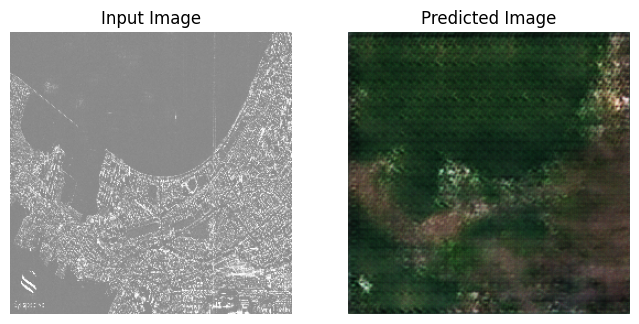

In [125]:
process_and_display_image(image_path, generator_path, discriminator_path)

In [126]:
!pip install visualkeras

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


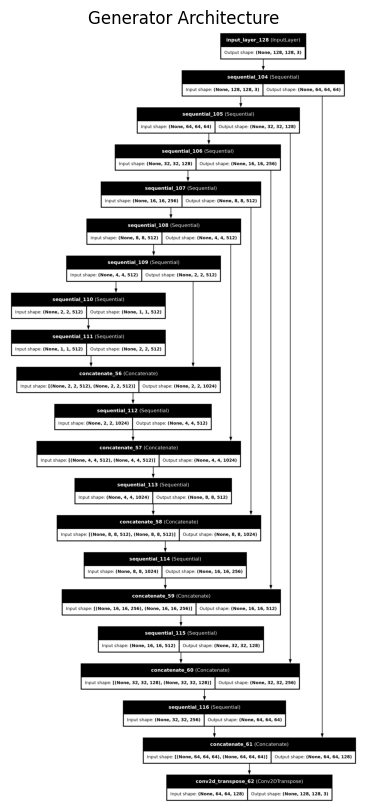

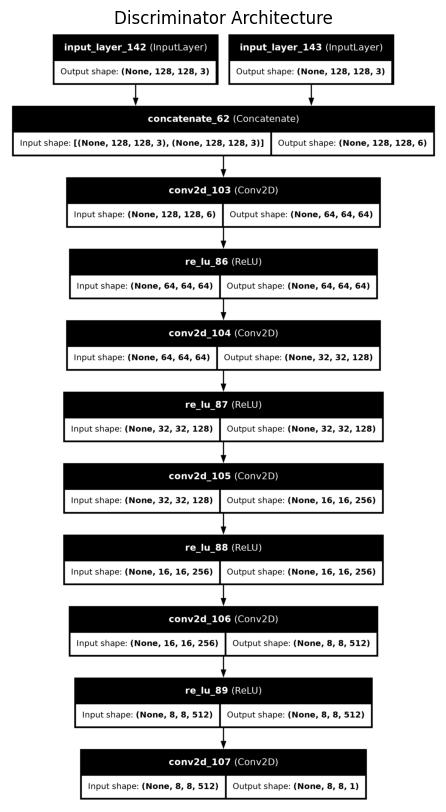

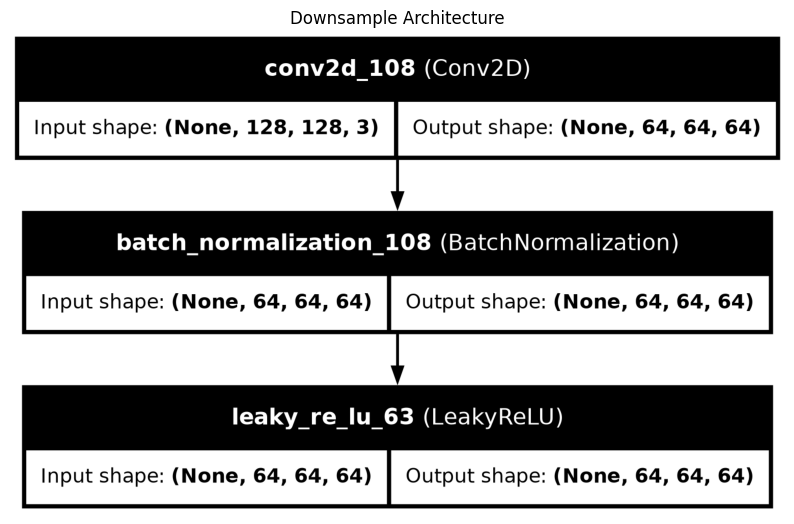

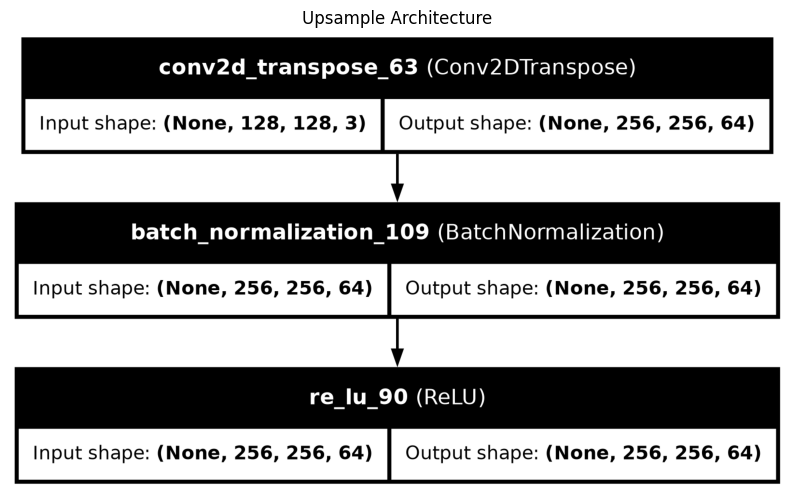

In [127]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter

def load_and_preprocess_image(image_path, target_size=(256, 256)):
    """Load and preprocess an image, converting grayscale to RGB."""
    img = image.load_img(image_path, color_mode='grayscale', target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Create a batch axis
    img_array = np.repeat(img_array, 3, axis=-1)  # Convert grayscale to RGB by repeating channels
    img_array = img_array / 255.0  # Normalize to [0, 1]
    return img_array

def load_models(generator_path='generator.h5', discriminator_path='discriminator.h5'):
    """Load the generator and discriminator models."""
    generator = tf.keras.models.load_model(generator_path)
    discriminator = tf.keras.models.load_model(discriminator_path)
    return generator, discriminator

def sharpen_image(image_array):
    """Apply sharpening filter to the image."""
    image_array = (image_array + 1) / 2  # Rescale back to [0, 1]
    image_array = np.clip(image_array, 0, 1)  # Clip values to the valid range
    img = Image.fromarray((image_array * 255).astype(np.uint8))  # Convert to PIL Image
    sharpened_img = img.filter(ImageFilter.SHARPEN)  # Apply sharpening filter
    return np.array(sharpened_img) / 255.0  # Normalize back to [0, 1]

def generate_images(model, test_input):
    """Generate and display images."""
    prediction = model(test_input, training=False)
    prediction = np.squeeze(prediction)  # Remove batch dimension
    
    # Sharpen the predicted image
    sharpened_prediction = sharpen_image(prediction)
    
    plt.figure(figsize=(15, 6))

    display_list = [test_input[0], prediction, sharpened_prediction]
    title = ['Input Image', 'Predicted Image', 'Sharpened Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(np.clip(display_list[i], 0, 1))  # Clip values to the valid range for display
        plt.axis('off')
    plt.show()

def process_and_display_image(image_path):
    """Load models, preprocess image, generate and display images."""
    # Load models
    generator, _ = load_models()
    
    # Preprocess image
    img_array = load_and_preprocess_image(image_path)
    
    # Generate and display images
    generate_images(generator, img_array)

if __name__ == "__main__":
    image_path = input("Enter the path to the image: ")
    process_and_display_image(image_path)
